In [43]:
import numpy as np 
import matplotlib.pyplot as plt
import glob
import cv2
import os
import seaborn as sns
import pandas as pd
import lightgbm as lgb
import random
import albumentations as A
import tensorflow as tf

from skimage.filters import sobel
from skimage.feature import greycomatrix, greycoprops
from skimage.measure import shannon_entropy

from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

from numpy import loadtxt
from xgboost import XGBClassifier

from tensorflow.keras import datasets, layers, models

from fastai.vision.all import *

# Data Processing

In [23]:
DATADIR = ("input/uisketch")
CATEGORIES = ['button', 'card','image']
SIZE = 150

In [221]:
train_images = []
train_labels = [] 
def create_training_data():
    for i in range(len(CATEGORIES)):
        category = CATEGORIES[i]
        path = os.path.join(DATADIR, category)
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path,img),0)
            new_array = cv2.resize(img_array, (SIZE, SIZE))
       
            train_images.append(new_array)
            train_labels.append(i)

create_training_data()
len(train_images)

3248

In [222]:
train_images = np.array(train_images)
train_labels = np.array(train_labels)


In [223]:

x_train, x_test, y_train, y_test = train_test_split(train_images, train_labels, test_size = 0.30)

In [224]:

le = preprocessing.LabelEncoder()
le.fit(y_test)
test_labels_encoded = le.transform(y_test)
le.fit(y_train)
train_labels_encoded = le.transform(y_train)

In [225]:
def feature_extractor(dataset):
    image_dataset = pd.DataFrame()
    for image in range(dataset.shape[0]):  #iterate through each file 
        #print(image)
        
        df = pd.DataFrame()  #Temporary data frame to capture information for each loop.
        #Reset dataframe to blank after each loop.
        
        img = dataset[image, :,:]
    ################################################################
    #START ADDING DATA TO THE DATAFRAME
  
                
         #Full image
        #GLCM = greycomatrix(img, [1], [0, np.pi/4, np.pi/2, 3*np.pi/4])
        GLCM = greycomatrix(img, [1], [0])       
        GLCM_Energy = greycoprops(GLCM, 'energy')[0]
        df['Energy'] = GLCM_Energy
        GLCM_corr = greycoprops(GLCM, 'correlation')[0]
        df['Corr'] = GLCM_corr       
        GLCM_diss = greycoprops(GLCM, 'dissimilarity')[0]
        df['Diss_sim'] = GLCM_diss       
        GLCM_hom = greycoprops(GLCM, 'homogeneity')[0]
        df['Homogen'] = GLCM_hom       
        GLCM_contr = greycoprops(GLCM, 'contrast')[0]
        df['Contrast'] = GLCM_contr


        GLCM2 = greycomatrix(img, [3], [0])       
        GLCM_Energy2 = greycoprops(GLCM2, 'energy')[0]
        df['Energy2'] = GLCM_Energy2
        GLCM_corr2 = greycoprops(GLCM2, 'correlation')[0]
        df['Corr2'] = GLCM_corr2       
        GLCM_diss2 = greycoprops(GLCM2, 'dissimilarity')[0]
        df['Diss_sim2'] = GLCM_diss2       
        GLCM_hom2 = greycoprops(GLCM2, 'homogeneity')[0]
        df['Homogen2'] = GLCM_hom2       
        GLCM_contr2 = greycoprops(GLCM2, 'contrast')[0]
        df['Contrast2'] = GLCM_contr2

        GLCM3 = greycomatrix(img, [5], [0])       
        GLCM_Energy3 = greycoprops(GLCM3, 'energy')[0]
        df['Energy3'] = GLCM_Energy3
        GLCM_corr3 = greycoprops(GLCM3, 'correlation')[0]
        df['Corr3'] = GLCM_corr3       
        GLCM_diss3 = greycoprops(GLCM3, 'dissimilarity')[0]
        df['Diss_sim3'] = GLCM_diss3       
        GLCM_hom3 = greycoprops(GLCM3, 'homogeneity')[0]
        df['Homogen3'] = GLCM_hom3       
        GLCM_contr3 = greycoprops(GLCM3, 'contrast')[0]
        df['Contrast3'] = GLCM_contr3

        GLCM4 = greycomatrix(img, [0], [np.pi/4])       
        GLCM_Energy4 = greycoprops(GLCM4, 'energy')[0]
        df['Energy4'] = GLCM_Energy4
        GLCM_corr4 = greycoprops(GLCM4, 'correlation')[0]
        df['Corr4'] = GLCM_corr4       
        GLCM_diss4 = greycoprops(GLCM4, 'dissimilarity')[0]
        df['Diss_sim4'] = GLCM_diss4       
        GLCM_hom4 = greycoprops(GLCM4, 'homogeneity')[0]
        df['Homogen4'] = GLCM_hom4       
        GLCM_contr4 = greycoprops(GLCM4, 'contrast')[0]
        df['Contrast4'] = GLCM_contr4
        
        GLCM5 = greycomatrix(img, [0], [np.pi/2])       
        GLCM_Energy5 = greycoprops(GLCM5, 'energy')[0]
        df['Energy5'] = GLCM_Energy5
        GLCM_corr5 = greycoprops(GLCM5, 'correlation')[0]
        df['Corr5'] = GLCM_corr5       
        GLCM_diss5 = greycoprops(GLCM5, 'dissimilarity')[0]
        df['Diss_sim5'] = GLCM_diss5       
        GLCM_hom5 = greycoprops(GLCM5, 'homogeneity')[0]
        df['Homogen5'] = GLCM_hom5       
        GLCM_contr5 = greycoprops(GLCM5, 'contrast')[0]
        df['Contrast5'] = GLCM_contr5
        
        #Add more filters as needed
        #entropy = shannon_entropy(img)
        #df['Entropy'] = entropy

        
        #Append features from current image to the dataset
        image_dataset = image_dataset.append(df)
        
    return image_dataset

In [226]:
image_features = feature_extractor(x_train)
X_for_ML =image_features

h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

In [227]:
X_for_ML.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Energy4,Corr4,Diss_sim4,Homogen4,Contrast4,Energy5,Corr5,Diss_sim5,Homogen5,Contrast5
count,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,...,2273.000000,2.273000e+03,2273.0,2.273000e+03,2273.0,2273.000000,2.273000e+03,2273.0,2.273000e+03,2273.0
mean,0.824356,0.781195,5.925012,0.892696,922.725761,0.808123,0.503040,12.177879,0.864651,2357.573959,...,0.854722,1.000000e+00,0.0,1.000000e+00,0.0,0.854722,1.000000e+00,0.0,1.000000e+00,0.0
std,0.080055,0.104366,2.937756,0.056391,509.839636,0.086303,0.168851,6.528988,0.068479,1398.576850,...,0.072366,1.355344e-16,0.0,7.984082e-17,0.0,0.072366,1.355344e-16,0.0,7.984082e-17,0.0
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,-0.009737,1.270295,0.550845,157.830476,...,0.508528,1.000000e+00,0.0,1.000000e+00,0.0,0.508528,1.000000e+00,0.0,1.000000e+00,0.0
25%,0.790827,0.707992,3.676600,0.869409,540.028635,0.768172,0.379054,6.601723,0.831744,1170.552200,...,0.830862,1.000000e+00,0.0,1.000000e+00,0.0,0.830862,1.000000e+00,0.0,1.000000e+00,0.0
50%,0.838770,0.781188,5.733423,0.903370,872.451454,0.822631,0.489668,11.749569,0.875949,2187.493333,...,0.870125,1.000000e+00,0.0,1.000000e+00,0.0,0.870125,1.000000e+00,0.0,1.000000e+00,0.0
75%,0.882065,0.853918,7.996868,0.932000,1256.549978,0.871363,0.607067,16.769524,0.914915,3344.707664,...,0.903393,1.000000e+00,0.0,1.000000e+00,0.0,0.903393,1.000000e+00,0.0,1.000000e+00,0.0
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,0.965497,1.000000e+00,0.0,1.000000e+00,0.0,0.965497,1.000000e+00,0.0,1.000000e+00,0.0


In [228]:
X_for_ML=X_for_ML.drop(['Diss_sim4','Contrast4','Diss_sim5','Contrast5'], axis=1)

In [337]:
X_for_ML=X_for_ML.reset_index(drop=True)

In [338]:
x=X_for_ML[X_for_ML['Corr2']<0].index.values
x

array([1133], dtype=int64)

In [229]:
try1 = X_for_ML
try1.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Corr3,Diss_sim3,Homogen3,Contrast3,Energy4,Corr4,Homogen4,Energy5,Corr5,Homogen5
count,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,...,2273.000000,2273.000000,2273.000000,2273.000000,2273.000000,2.273000e+03,2.273000e+03,2273.000000,2.273000e+03,2.273000e+03
mean,0.824356,0.781195,5.925012,0.892696,922.725761,0.808123,0.503040,12.177879,0.864651,2357.573959,...,0.422279,14.580337,0.846716,2879.732192,0.854722,1.000000e+00,1.000000e+00,0.854722,1.000000e+00,1.000000e+00
std,0.080055,0.104366,2.937756,0.056391,509.839636,0.086303,0.168851,6.528988,0.068479,1398.576850,...,0.170827,8.352221,0.076763,1849.105923,0.072366,1.355344e-16,7.984082e-17,0.072366,1.355344e-16,7.984082e-17
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,-0.009737,1.270295,0.550845,157.830476,...,-0.019409,1.620138,0.516287,215.286805,0.508528,1.000000e+00,1.000000e+00,0.508528,1.000000e+00,1.000000e+00
25%,0.790827,0.707992,3.676600,0.869409,540.028635,0.768172,0.379054,6.601723,0.831744,1170.552200,...,0.293964,7.667586,0.807838,1365.835862,0.830862,1.000000e+00,1.000000e+00,0.830862,1.000000e+00,1.000000e+00
50%,0.838770,0.781188,5.733423,0.903370,872.451454,0.822631,0.489668,11.749569,0.875949,2187.493333,...,0.402439,13.292506,0.859012,2520.471816,0.870125,1.000000e+00,1.000000e+00,0.870125,1.000000e+00,1.000000e+00
75%,0.882065,0.853918,7.996868,0.932000,1256.549978,0.871363,0.607067,16.769524,0.914915,3344.707664,...,0.530614,19.756506,0.905152,4011.055816,0.903393,1.000000e+00,1.000000e+00,0.903393,1.000000e+00,1.000000e+00
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,0.880483,45.784092,0.975830,10885.463908,0.965497,1.000000e+00,1.000000e+00,0.965497,1.000000e+00,1.000000e+00


In [230]:
try1=try1.assign(Output = y_train)

try1 = try1[try1.select_dtypes(include=[np.number]).ge(0).all(1)]

In [231]:
try1.describe()

,Energy,Corr,Diss_sim,Homogen,Contrast,Energy2,Corr2,Diss_sim2,Homogen2,Contrast2,...,Diss_sim3,Homogen3,Contrast3,Energy4,Corr4,Homogen4,Energy5,Corr5,Homogen5,Output
count,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,2272.000000,...,2272.000000,2272.000000,2272.000000,2272.000000,2.272000e+03,2.272000e+03,2272.000000,2.272000e+03,2.272000e+03,2272.000000
mean,0.824341,0.781275,5.924319,0.892691,922.608002,0.808109,0.503266,12.176697,0.864646,2357.270155,...,14.580028,0.846710,2879.627422,0.854704,1.000000e+00,1.000000e+00,0.854704,1.000000e+00,1.000000e+00,0.977113
std,0.080069,0.104320,2.938217,0.056403,509.920954,0.086320,0.168545,6.530182,0.068494,1398.809717,...,8.354047,0.076780,1849.506243,0.072377,1.355642e-16,7.985840e-17,0.072377,1.355642e-16,7.985840e-17,0.839054
min,0.465619,0.425529,0.701119,0.626863,62.667383,0.432672,0.098186,1.270295,0.550845,157.830476,...,1.620138,0.516287,215.286805,0.508528,1.000000e+00,1.000000e+00,0.508528,1.000000e+00,1.000000e+00,0.000000
25%,0.790824,0.708137,3.674877,0.869402,539.897942,0.768169,0.379383,6.596327,0.831736,1169.271837,...,7.664046,0.807834,1365.706966,0.830847,1.000000e+00,1.000000e+00,0.830847,1.000000e+00,1.000000e+00,0.000000
50%,0.838656,0.781300,5.732796,0.903321,872.254094,0.822601,0.490185,11.749070,0.875959,2187.154331,...,13.285977,0.858983,2518.309287,0.870092,1.000000e+00,1.000000e+00,0.870092,1.000000e+00,1.000000e+00,1.000000
75%,0.882067,0.853951,7.996913,0.932000,1256.611230,0.871375,0.607152,16.771565,0.915035,3344.709184,...,19.758874,0.905152,4011.055816,0.903417,1.000000e+00,1.000000e+00,0.903417,1.000000e+00,1.000000e+00,2.000000
max,0.954359,0.984953,16.660582,0.984550,2751.773154,0.950887,0.918524,35.377234,0.979815,7214.223764,...,45.784092,0.975830,10885.463908,0.965497,1.000000e+00,1.000000e+00,0.965497,1.000000e+00,1.000000e+00,2.000000


In [232]:
y_train = try1[['Output']].copy()

In [233]:
try1 = try1.drop('Output',axis= 1)

In [235]:
select = SelectKBest(score_func=chi2, k=3)
# make 3,4,5
z = select.fit_transform(try1,y_train)
 
print("After selecting best 3 features:", z.shape) 


After selecting best 3 features: (2272, 3)


In [267]:
cols = select.get_support(indices=True)
train_features_new = try1.iloc[:,cols]
train_features_new.shape



(2272, 3)

In [268]:

d_train = lgb.Dataset(train_features_new, label=y_train)

In [269]:
lgbm_params = {'learning_rate':0.05, 'boosting_type':'dart',    
              'objective':'multiclass',
              'metric': 'multi_logloss',
              'num_leaves':100,
              'max_depth':10,
              'num_class':4}

lgb_model = lgb.train(lgbm_params, d_train, 100)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000435 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 765
[LightGBM] [Info] Number of data points in the train set: 2272, number of used features: 3
[LightGBM] [Info] Start training from score -1.011821
[LightGBM] [Info] Start training from score -1.218157
[LightGBM] [Info] Start training from score -1.076844
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

In [270]:
test_features = feature_extractor(x_test)
cols = select.get_support(indices=True)
test_features_new = test_features.iloc[:,cols]


h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

In [272]:
test_features_new = np.expand_dims(test_features_new, axis=0)
test_for_RF = np.reshape(test_features_new, (x_test.shape[0], -1))

In [273]:
test_prediction = lgb_model.predict(test_for_RF)
test_prediction=np.argmax(test_prediction, axis=1)
#Inverse le transform to get original label back. 
test_prediction = le.inverse_transform(test_prediction)

In [274]:

print ("Accuracy = ", metrics.accuracy_score(y_test, test_prediction))

Accuracy =  0.7282051282051282


<AxesSubplot: >

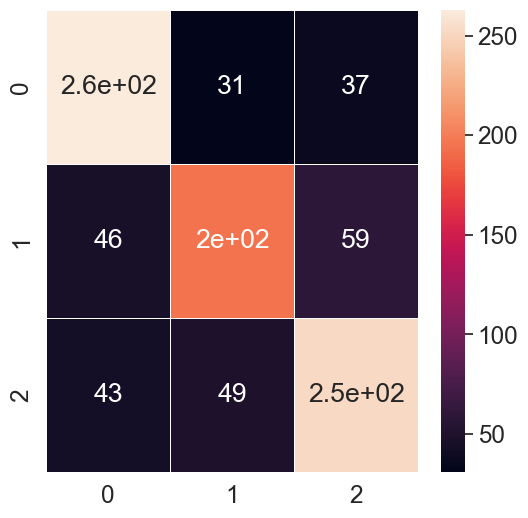

In [288]:

cm = confusion_matrix(y_test, test_prediction)

fig, ax = plt.subplots(figsize=(6,6))         # Sample figsize in inches
sns.set(font_scale=1.6)
sns.heatmap(cm, annot=True, linewidths=.5, ax=ax)


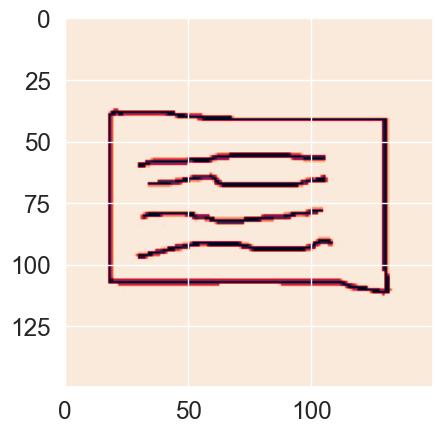

In [285]:

n=random.randint(0, x_test.shape[0]-1) #Select the index of image to be loaded for testing
img = x_test[n]
plt.imshow(img)

In [287]:
input_img = np.expand_dims(img, axis=0) #Expand dims so the input is (num images, x, y, c)
input_img_features=feature_extractor(input_img)
input_img_new = input_img_features.iloc[:,cols]
input_img_new = np.expand_dims(input_img_new, axis=0)
input_img_for_RF = np.reshape(input_img_new, (input_img.shape[0], -1))
#Predict
img_prediction = lgb_model.predict(input_img_for_RF)
img_prediction=np.argmax(img_prediction, axis=1)
img_prediction = le.inverse_transform([img_prediction])  #Reverse the label encoder to original name
print("The prediction for this image is: ", img_prediction)
print("The actual label for this image is: ", test_labels[n])

The prediction for this image is:  [1]
The actual label for this image is:  0


h:\Python\lib\site-packages\skimage\feature\__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
h:\Python\lib\site-packages\skimage\feature\__init__.py:42: skimage_deprecation: Function ``gr

pip install xgboost

In [292]:
# fit model no training data
model = XGBClassifier()
model.fit(train_features_new, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [294]:

# make predictions for test data
y_pred = model.predict(test_for_RF)
predictions = [round(value) for value in y_pred]

In [296]:

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 72.62%


CNN

In [392]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(SIZE, SIZE,1)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(10))
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [347]:
x_train = x_train.reshape(x_train.shape[0], 150, 150, 1)
x_train.shape

(2273, 150, 150, 1)

In [348]:

x_train_new = np.delete(x_train, 1, 0)
x_train_new.shape

(2272, 150, 150, 1)

In [407]:
train_images.shape,train_labels.shape

((3248, 150, 150), (3248,))

In [409]:

x_train_cnn, x_test_cnn, y_train_cnn, y_test_cnn = train_test_split(train_images, train_labels, test_size = 0.30)

In [411]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
validation_split = 0.2
train_datagen = ImageDataGenerator(
    validation_split=0.2, 
    rescale=1./255,
    rotation_range=40,
    zoom_range=0.02,
)



# train_images_new = train_images.reshape(train_images.shape[0], 150, 150, 1)

x_train_cnn = x_train_cnn.reshape(x_train_cnn.shape[0], 150, 150, 1)
x_test_cnn = x_test_cnn.reshape(x_test_cnn.shape[0], 150, 150, 1)

train_iterator= train_datagen.flow(
    x=x_train_cnn,
    y=y_train_cnn,
    batch_size=150,
    subset='training'
)


validation_iterator= train_datagen.flow(
    x=x_test_cnn,
    y=y_test_cnn,
    batch_size=150,
    subset='validation'
)


In [394]:
x_test = x_test.reshape(x_test.shape[0], 150, 150, 1)
x_test.shape

(975, 150, 150, 1)

In [412]:
# history = model.fit(x_train, y_train, epochs=10, 
#                     validation_data=(x_test, y_test))
valid_input_length = int(len(x_train_cnn)*validation_split)
train_input_length = int(len(x_train_cnn)-valid_input_length)

history = model.fit_generator(
    generator=train_iterator,
    steps_per_epoch= train_input_length // 150,
    validation_data=validation_iterator,
    validation_steps= valid_input_length // 150,
    epochs=25, 

)

C:\Users\Taz\AppData\Local\Temp\ipykernel_5940\3355539336.py:6: UserWarning: `model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(


Epoch 1/25
12/12 [==============================] - ETA: 0s - batch: 5.5000 - size: 150.0000 - loss: 2.1557 - acc: 0.3317

h:\Python\lib\site-packages\keras\engine\training_v1.py:2333: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates


12/12 [==============================] - 45s 4s/step - batch: 5.5000 - size: 150.0000 - loss: 2.1557 - acc: 0.3317 - val_loss: 1.9803 - val_acc: 0.3565
Epoch 2/25
12/12 [==============================] - 25s 2s/step - batch: 5.5000 - size: 128.1667 - loss: 1.8572 - acc: 0.3303 - val_loss: 1.6591 - val_acc: 0.3710
Epoch 3/25
12/12 [==============================] - 29s 2s/step - batch: 5.5000 - size: 150.0000 - loss: 1.6171 - acc: 0.3389 - val_loss: 1.4859 - val_acc: 0.3449
Epoch 4/25
12/12 [==============================] - 25s 2s/step - batch: 5.5000 - size: 128.1667 - loss: 1.4171 - acc: 0.3394 - val_loss: 1.2723 - val_acc: 0.3565
Epoch 5/25
12/12 [==============================] - 30s 3s/step - batch: 5.5000 - size: 150.0000 - loss: 1.2423 - acc: 0.3167 - val_loss: 1.1792 - val_acc: 0.3188
Epoch 6/25
12/12 [==============================] - 28s 2s/step - batch: 5.5000 - size: 128.1667 - loss: 1.1592 - acc: 0.3732 - val_loss: 1.1451 - val_acc: 0.3333
Epoch 7/25
12/12 [===============

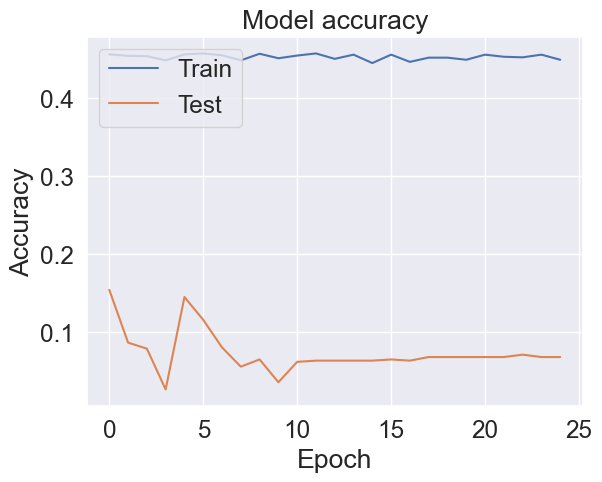

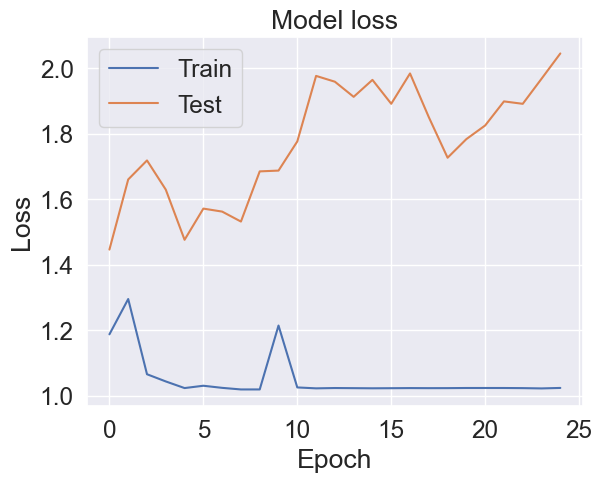

In [364]:
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()


plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

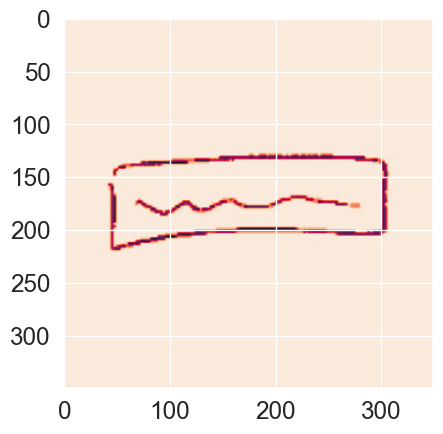

In [368]:
new_array = cv2.resize(train_images[0], (350, 350))
plt.imshow(new_array)
plt.show()

CNN with RestNet

h:\Python\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Set seed for reproducibility
SEED = 42

In [3]:
path = Path("input/uisketch")
model_path = Path("./models")
model_path.mkdir(exist_ok=True)

In [4]:
df = pd.read_csv(path / "labels.csv")
df.head()

,name,label,medium,device
0,button/0000.jpg,button,paper,pen
1,button/0001.jpg,button,digital,stylus
2,button/0002.jpg,button,digital,stylus
3,button/0003.jpg,button,digital,stylus
4,button/0004.jpg,button,digital,stylus


In [5]:
train_df, test_df = train_test_split(df, test_size=0.1, random_state=SEED, stratify=df.label.values) 
# Split dataset for training/validation/evaluation

In [6]:
class InvertImage(Transform):
        
    def encodes(self, img: PILImage):
        np_img = np.array(img)
        aug_img = A.transforms.InvertImg(p=1)(image=np_img)['image']
        return PILImage.create(aug_img)

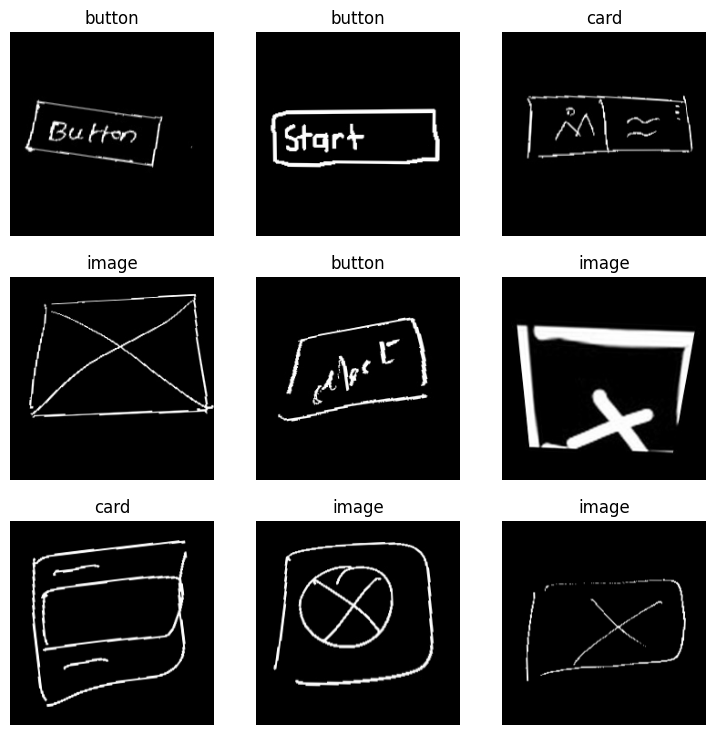

In [7]:
transforms = [*aug_transforms(do_flip=False, pad_mode='border')]

uisketch = DataBlock(blocks=(ImageBlock, CategoryBlock),
                     get_x=ColReader(0, pref=path),
                     get_y=ColReader(1),
                     splitter=TrainTestSplitter(test_size=0.1, random_state=SEED, stratify=train_df.label.values),
                     item_tfms=[InvertImage()],
                     batch_tfms=[*transforms, Normalize.from_stats(*imagenet_stats)])

dataloaders = uisketch.dataloaders(train_df)

dataloaders.show_batch()

In [10]:
model = cnn_learner(dataloaders, resnet18, metrics=error_rate)
model.fine_tune(4)

h:\Python\lib\site-packages\fastai\vision\learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
h:\Python\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
h:\Python\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to C:\Users\Taz/.cache\torch\hub\checkpoints\resnet18-f37072fd.pth
100%|██████████| 44.7M/4

epoch,train_loss,valid_loss,error_rate,time
0,0.829153,0.576957,0.118321,03:34


epoch,train_loss,valid_loss,error_rate,time
0,0.386759,0.217328,0.080153,03:40
1,0.303890,0.209551,0.053435,03:27
2,0.221995,0.153403,0.057252,03:31
3,0.153475,0.128455,0.038168,03:37


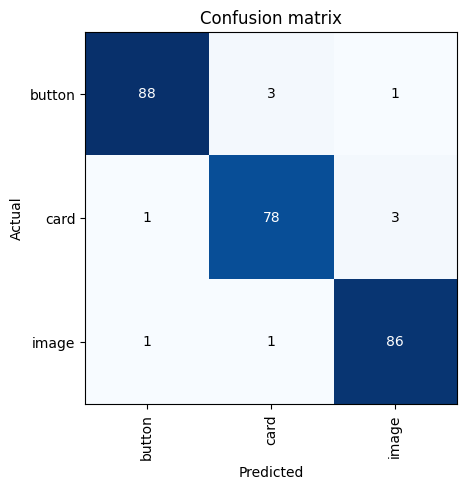

In [13]:
interp = ClassificationInterpretation.from_learner(model)
interp.plot_confusion_matrix()

In [14]:
interp.print_classification_report()

              precision    recall  f1-score   support

      button       0.98      0.96      0.97        92
        card       0.95      0.95      0.95        82
       image       0.96      0.98      0.97        88

    accuracy                           0.96       262
   macro avg       0.96      0.96      0.96       262
weighted avg       0.96      0.96      0.96       262



Evaluation

In [15]:
test_dataloader = dataloaders.test_dl(test_df, with_labels=True)

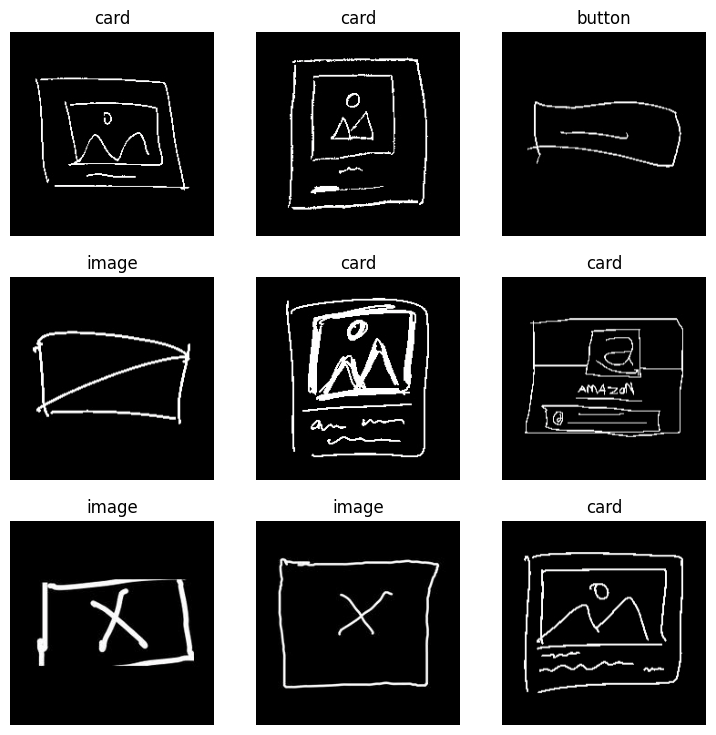

In [16]:
test_dataloader.show_batch()

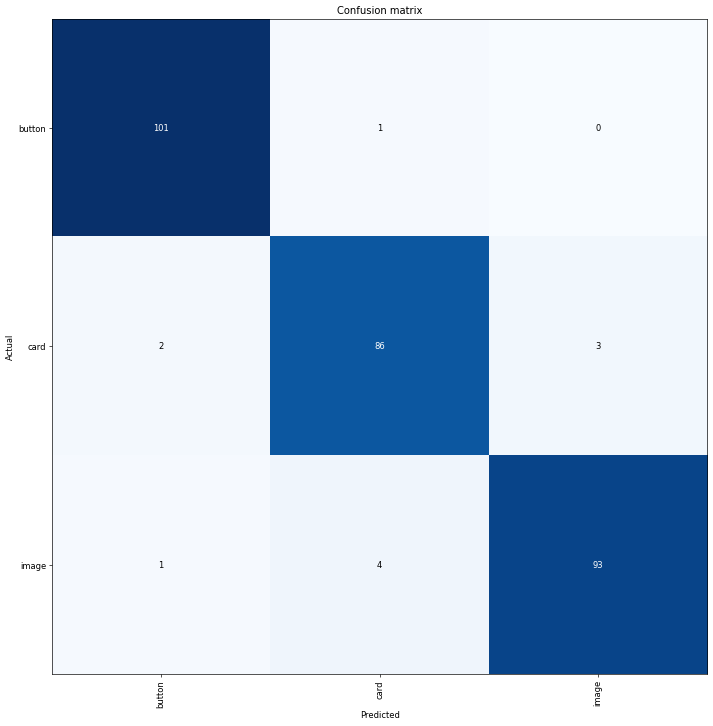

In [17]:
interp = ClassificationInterpretation.from_learner(model, dl=test_dataloader)
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

In [19]:
interp.print_classification_report()

              precision    recall  f1-score   support

      button       0.97      0.99      0.98       102
        card       0.95      0.95      0.95        91
       image       0.97      0.95      0.96        98

    accuracy                           0.96       291
   macro avg       0.96      0.96      0.96       291
weighted avg       0.96      0.96      0.96       291



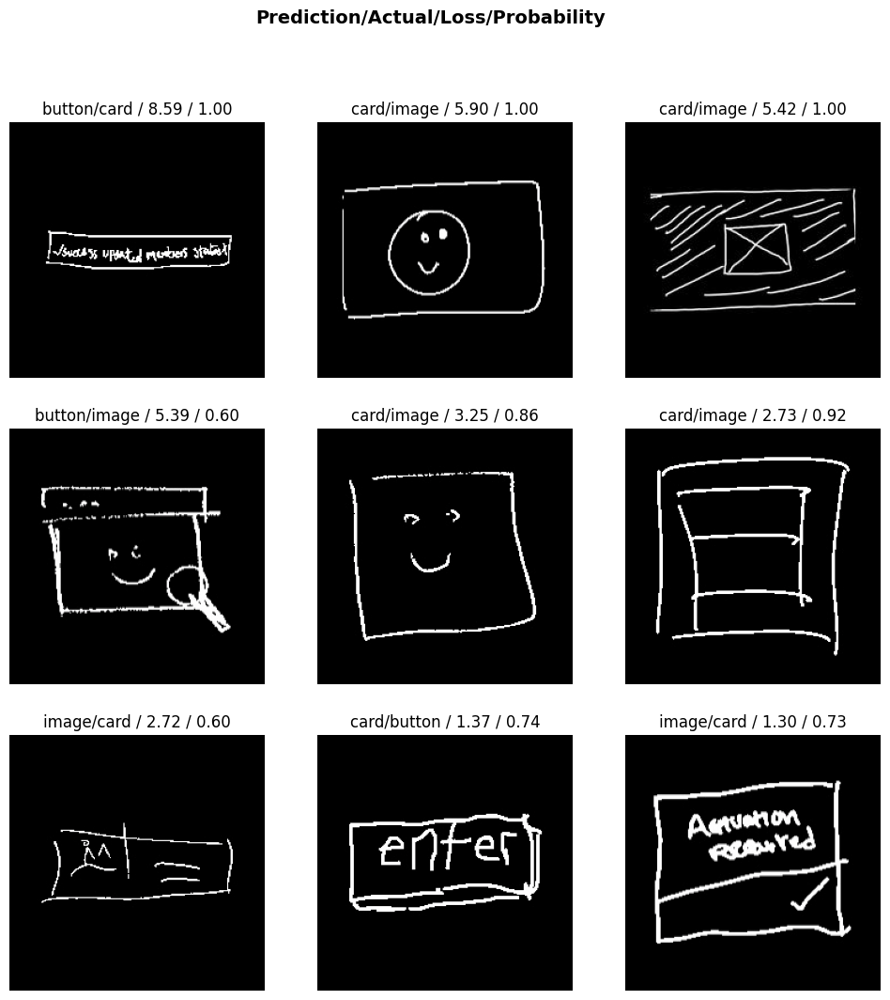

In [20]:
interp.plot_top_losses(9, figsize=(12,12))

In [38]:
vgg16_model = cnn_learner(dataloaders, models.squeezenet1_0, metrics =accuracy)
vgg16_model.fine_tune(4)

epoch,train_loss,valid_loss,accuracy,time
0,0.811937,0.391813,0.912214,02:51


epoch,train_loss,valid_loss,accuracy,time
0,0.313310,0.431177,0.893130,04:03
1,0.288582,0.175125,0.950382,03:20
2,0.241133,0.220492,0.935115,03:20
3,0.206946,0.165939,0.950382,03:17


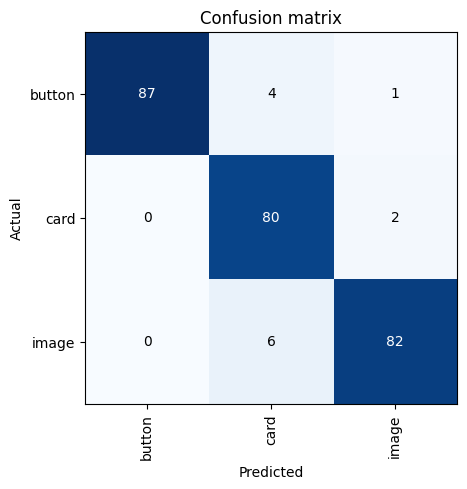

In [39]:
interp = ClassificationInterpretation.from_learner(vgg16_model)
interp.plot_confusion_matrix()

In [40]:
interp.print_classification_report()

              precision    recall  f1-score   support

      button       1.00      0.95      0.97        92
        card       0.89      0.98      0.93        82
       image       0.96      0.93      0.95        88

    accuracy                           0.95       262
   macro avg       0.95      0.95      0.95       262
weighted avg       0.95      0.95      0.95       262

